In [1]:
%runfile H3.py

In [2]:
from utils import (make_M_alphas, 
                   make_poly_from_edges, 
                   poly_equiv, tri0, tri1, tri2, cycle_poly, std_poly,
                   poly_gl2_orbit_reps, 
                   aas_triangle_gl2_orbit_reps, 
                   square_parameters, 
                   aaa_triangle_parameters, 
                   aas_triangle_parameters)

In [3]:
kdata = make_k(-43)
k = kdata['k']
w = kdata['w']
zero = k(0)
one = k(1)
Ireps = kdata['Ireps']
inf = cusp(infinity, k)

In [4]:
alphas = precomputed_alphas(k)
sigmas = singular_points_new(k)
assert sigmas == [inf]

M_alphas, alpha_inv = make_M_alphas(alphas)

In [5]:
polys, hemis = all_polyhedra(k)

New orbit from P_0=[11/43*w + 16/43, 2/43]: {0}
New orbit from P_1=[-11/43*w + 27/43, 2/43]: {1}
New orbit from P_2=[12/43*w + 25/129, 20/387]: {2, 5, 6}
New orbit from P_3=[-12/43*w - 25/129, 20/387]: {3, 4, 7}
New orbit from P_8=[38/129*w - 19/129, 26/387]: {8, 10, 13}
New orbit from P_9=[-38/129*w + 19/129, 26/387]: {9, 11, 12}
New orbit from P_14=[17/43*w + 13/43, 3/43]: {14}
New orbit from P_15=[-17/43*w + 30/43, 3/43]: {15}
Found [[3, 4, 7], [14], [9, 11, 12], [1], [2, 5, 6], [15], [8, 10, 13], [0]] orbits:
Constructed 8 polyhedra
Faces: [[4, 6, 3, 4, 4, 3, 3, 3], [4, 4, 3, 3, 4], [4, 3, 4, 3, 4], [6, 6, 3, 6, 3, 3, 6, 3], [4, 4, 3, 3, 4, 3, 6, 3], [4, 3, 4, 3, 4], [4, 3, 4, 3, 4], [6, 6, 3, 6, 3, 3, 6, 3]]


EW's corners (up to $\pm$ and conjugation)

In [6]:
EW_corners = [
[25*(2*w-1)/(3*43), (2/3)^2 * (5/43)], 
[1/3+8*(2*w-1)/(43), (1/3)^2 * (26/43)],
[1/2+17*(2*w-1)/(2*43), (3/43)],
[19*(2*w-1)/(3*43), (1/3)^2 * (26/43)],
[1/3+6*(2*w-1)/(43), (2/3)^2 * (5/43)],
[1/2+11*(2*w-1)/(2*43),  (2/43)]]
for P in EW_corners:
    print(P)

[50/129*w - 25/129, 20/387]
[16/43*w + 19/129, 26/387]
[17/43*w + 13/43, 3/43]
[38/129*w - 19/129, 26/387]
[12/43*w + 25/129, 20/387]
[11/43*w + 16/43, 2/43]


In [7]:
assert len(polys)==8

We should have 2 hexagonal caps, 4 triangular prisms, and 2 truncated tetrahedra

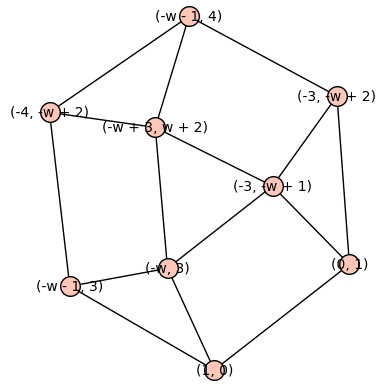

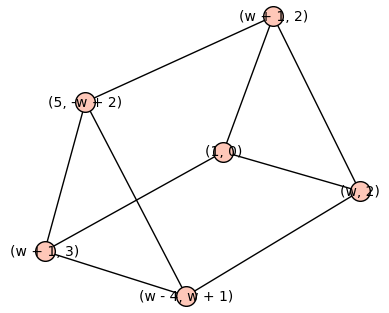

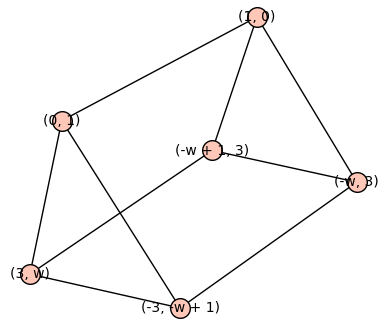

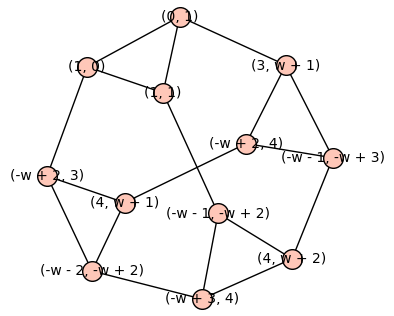

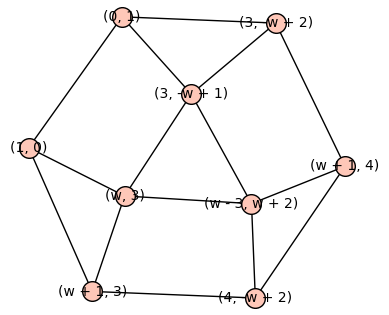

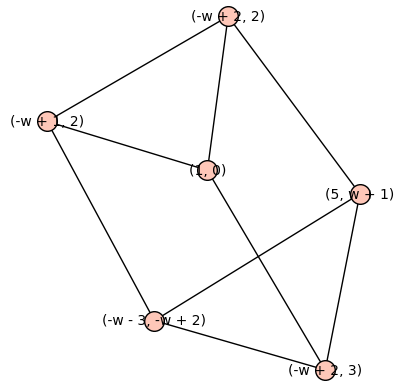

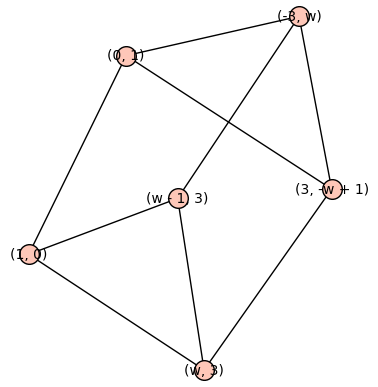

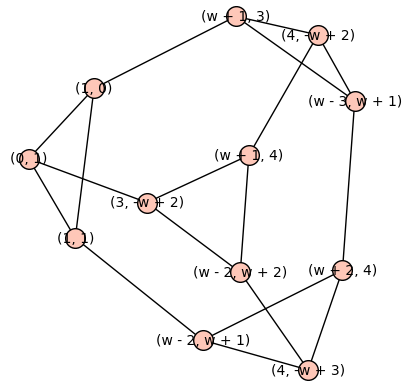

In [8]:
for G in polys: show(G) 

In [9]:
triangles = [make_poly_from_edges(t, k) for t in sum([[F for F in G.faces() if len(F)==3] for G in polys],[])]
squares = [make_poly_from_edges(t, k) for t in sum([[F for F in G.faces() if len(F)==4] for G in polys],[])]
hexagons = [make_poly_from_edges(t, k) for t in sum([[F for F in G.faces() if len(F)==6] for G in polys],[])]
aaa_triangles = [T for T in triangles if is_poly_principal(T)]
#aas_triangles = [T for T in triangles if not is_poly_principal(T)]

In [10]:
[len(t) for t in [aaa_triangles, squares, hexagons]]

[24, 18, 10]

In [11]:
aaa_triangles0 = poly_gl2_orbit_reps(aaa_triangles, alphas)
squares0 = poly_gl2_orbit_reps(squares, alphas)
hexagons0 = poly_gl2_orbit_reps(hexagons, alphas)

In [12]:
[len(t) for t in [aaa_triangles0, squares0, hexagons0]]

[3, 2, 1]

In [13]:
[square_parameters(S, alphas, M_alphas, alpha_inv) for S in squares0]

[[[0, 3, 2, 4], [0, 0, 0]], [[7, 2, 7, 2], [-1, 1, 0]]]

In [14]:
triangles1 = [T for T in aaa_triangles0 if not any(poly_equiv(T, t) for t in [tri0(k), tri1(k), tri2(k)])]
triangles1

[[[-w + 1:-3], oo, [-w:-3]]]

In [15]:
[aaa_triangle_parameters(T, alphas, M_alphas) for T in triangles1]

[[6, 3, 8]]

In [16]:
plot_Bianchi_diagram(k,hemis)

Graphics3d Object

In [17]:
from polyhedra import all_poly_types, poly_types

In [18]:
poly_types(polys)

{'tetrahedron': 0,
 'square prism': 0,
 'triangular prism': 4,
 'hexagonal cap': 2,
 'truncated tetrahedron': 2,
 'cuboctahedron': 0}

In [20]:
all_poly_types(polys)

['hexagonal cap',
 'triangular prism',
 'triangular prism',
 'truncated tetrahedron',
 'hexagonal cap',
 'triangular prism',
 'triangular prism',
 'truncated tetrahedron']